In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.model_selection import train_test_split
import category_encoders as ce
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, BaggingClassifier,StackingClassifier
import xgboost as xgb

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score

In [2]:
df = pd.read_csv(r"C:\Users\hp\Downloads\customer_booking.csv", encoding="latin-1")
df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,RoundTrip,27,6,9,Sat,PERPNH,Australia,1,0,1,5.62,0
49996,1,Internet,RoundTrip,111,6,4,Sun,PERPNH,Australia,0,0,0,5.62,0
49997,1,Internet,RoundTrip,24,6,22,Sat,PERPNH,Australia,0,0,1,5.62,0
49998,1,Internet,RoundTrip,15,6,11,Mon,PERPNH,Australia,1,0,1,5.62,0


# DATA CLEANİNG

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         50000 non-null  int64  
 1   sales_channel          50000 non-null  object 
 2   trip_type              50000 non-null  object 
 3   purchase_lead          50000 non-null  int64  
 4   length_of_stay         50000 non-null  int64  
 5   flight_hour            50000 non-null  int64  
 6   flight_day             50000 non-null  object 
 7   route                  50000 non-null  object 
 8   booking_origin         50000 non-null  object 
 9   wants_extra_baggage    50000 non-null  int64  
 10  wants_preferred_seat   50000 non-null  int64  
 11  wants_in_flight_meals  50000 non-null  int64  
 12  flight_duration        50000 non-null  float64
 13  booking_complete       50000 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.3+ 

In [4]:
df.head(5)

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0


In [5]:
df.tail(5)

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
49995,2,Internet,RoundTrip,27,6,9,Sat,PERPNH,Australia,1,0,1,5.62,0
49996,1,Internet,RoundTrip,111,6,4,Sun,PERPNH,Australia,0,0,0,5.62,0
49997,1,Internet,RoundTrip,24,6,22,Sat,PERPNH,Australia,0,0,1,5.62,0
49998,1,Internet,RoundTrip,15,6,11,Mon,PERPNH,Australia,1,0,1,5.62,0
49999,1,Internet,RoundTrip,19,6,10,Thu,PERPNH,Australia,0,1,0,5.62,0


In [6]:
df.describe()

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
count,50000.000000,50000.000000,50000.00000,50000.00000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,1.591240,84.940480,23.04456,9.06634,0.668780,0.296960,0.427140,7.277561,0.149560
std,1.020165,90.451378,33.88767,5.41266,0.470657,0.456923,0.494668,1.496863,0.356643
min,1.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,4.670000,0.000000
25%,1.000000,21.000000,5.00000,5.00000,0.000000,0.000000,0.000000,5.620000,0.000000
50%,1.000000,51.000000,17.00000,9.00000,1.000000,0.000000,0.000000,7.570000,0.000000
75%,2.000000,115.000000,28.00000,13.00000,1.000000,1.000000,1.000000,8.830000,0.000000
max,9.000000,867.000000,778.00000,23.00000,1.000000,1.000000,1.000000,9.500000,1.000000


In [7]:
df.nunique()

num_passengers             9
sales_channel              2
trip_type                  3
purchase_lead            470
length_of_stay           335
flight_hour               24
flight_day                 7
route                    799
booking_origin           104
wants_extra_baggage        2
wants_preferred_seat       2
wants_in_flight_meals      2
flight_duration           21
booking_complete           2
dtype: int64

In [8]:
for column in df.columns:
    unique_values = df[column].unique()
    print(f"Unikal dəyərlər {column} sütununda:")
    print(unique_values)
    print("\n")


Unikal dəyərlər num_passengers sütununda:
[2 1 3 4 6 5 7 9 8]


Unikal dəyərlər sales_channel sütununda:
['Internet' 'Mobile']


Unikal dəyərlər trip_type sütununda:
['RoundTrip' 'CircleTrip' 'OneWay']


Unikal dəyərlər purchase_lead sütununda:
[262 112 243  96  68   3 201 238  80 378 185   8 265 245 192 259  19  67
 351 228  21  23  25  16  66  51  37 101   7   5  33  20  56  13  71 346
   9  65 221 107  14  77  24  47  22  11  35 272 250 161 128 190 311  27
 314 102   2  26  32  57 198 120  69 281 282  15  31 316 232 156 196 283
  34  63   6 227 181 138 134  85  93 118  90 168 127  18 153 186 263 172
 230  42  81 140 285 179 341 173 180 366 229 174  82  75 163 105 276 110
  83 154  55  45  54 193  10 166  97 239 182  99  53  28 384  70 126 142
  87  86 313  41  91 206 197 268 157 145 241 139  59 396 280  79 380 132
 121 419  58 115 236 225 116 191 275 417 159  92 106 218 295  12 305 235
 332 125 204 310 368 169 214 155 325 130 189 226 122  88 211 188 129 149
  38 194 183  40  95 135 

In [9]:
df["booking_origin"] = df["booking_origin"].replace("R\x82union","Reunion")
df["booking_origin"] = df["booking_origin"].replace("(not set)",np.nan)

In [10]:
df["booking_origin"].unique()

array(['New Zealand', 'India', 'United Kingdom', 'China', 'South Korea',
       'Japan', 'Malaysia', 'Singapore', 'Switzerland', 'Germany',
       'Indonesia', 'Czech Republic', 'Vietnam', 'Thailand', 'Spain',
       'Romania', 'Ireland', 'Italy', 'Slovakia', 'United Arab Emirates',
       'Tonga', 'Reunion', nan, 'Saudi Arabia', 'Netherlands', 'Qatar',
       'Hong Kong', 'Philippines', 'Sri Lanka', 'France', 'Croatia',
       'United States', 'Laos', 'Hungary', 'Portugal', 'Cyprus',
       'Australia', 'Cambodia', 'Poland', 'Belgium', 'Oman', 'Bangladesh',
       'Kazakhstan', 'Brazil', 'Turkey', 'Kenya', 'Taiwan', 'Brunei',
       'Chile', 'Bulgaria', 'Ukraine', 'Denmark', 'Colombia', 'Iran',
       'Bahrain', 'Solomon Islands', 'Slovenia', 'Mauritius', 'Nepal',
       'Russia', 'Kuwait', 'Mexico', 'Sweden', 'Austria', 'Lebanon',
       'Jordan', 'Greece', 'Mongolia', 'Canada', 'Tanzania', 'Peru',
       'Timor-Leste', 'Argentina', 'New Caledonia', 'Macau',
       'Myanmar (Burma)',

In [11]:
df.isna().sum()

num_passengers            0
sales_channel             0
trip_type                 0
purchase_lead             0
length_of_stay            0
flight_hour               0
flight_day                0
route                     0
booking_origin           84
wants_extra_baggage       0
wants_preferred_seat      0
wants_in_flight_meals     0
flight_duration           0
booking_complete          0
dtype: int64

In [12]:
df["booking_origin"].value_counts()

booking_origin
Australia               17872
Malaysia                 7174
South Korea              4559
Japan                    3885
China                    3387
                        ...  
Panama                      1
Tonga                       1
Tanzania                    1
Bulgaria                    1
Svalbard & Jan Mayen        1
Name: count, Length: 103, dtype: int64

In [13]:
df["booking_origin"] = df["booking_origin"].fillna(df["booking_origin"].value_counts().index[0])

In [14]:
df.isna().sum()

num_passengers           0
sales_channel            0
trip_type                0
purchase_lead            0
length_of_stay           0
flight_hour              0
flight_day               0
route                    0
booking_origin           0
wants_extra_baggage      0
wants_preferred_seat     0
wants_in_flight_meals    0
flight_duration          0
booking_complete         0
dtype: int64

In [15]:
df.duplicated().any()

True

In [16]:
df[df.duplicated()]

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
196,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
316,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
384,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
456,1,Internet,RoundTrip,30,85,15,Fri,AKLKUL,Malaysia,1,0,0,8.83,1
513,3,Internet,RoundTrip,109,20,4,Tue,AKLKUL,Singapore,1,0,1,8.83,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49852,2,Internet,RoundTrip,204,6,14,Tue,PENTPE,Malaysia,1,0,0,4.67,0
49902,1,Mobile,RoundTrip,106,6,11,Fri,PENTPE,Taiwan,1,0,0,4.67,0
49934,1,Internet,RoundTrip,2,6,3,Thu,PENTPE,Malaysia,0,0,1,4.67,0
49944,1,Internet,RoundTrip,2,6,3,Thu,PENTPE,Malaysia,0,0,1,4.67,0


In [17]:
df = df.drop_duplicates()

In [18]:
df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,RoundTrip,27,6,9,Sat,PERPNH,Australia,1,0,1,5.62,0
49996,1,Internet,RoundTrip,111,6,4,Sun,PERPNH,Australia,0,0,0,5.62,0
49997,1,Internet,RoundTrip,24,6,22,Sat,PERPNH,Australia,0,0,1,5.62,0
49998,1,Internet,RoundTrip,15,6,11,Mon,PERPNH,Australia,1,0,1,5.62,0


In [19]:
for i in df.select_dtypes(exclude="object"):
    fig=px.box(df, y=i)
    fig.show()

In [20]:
def outliers(melumat):    
    for col in melumat.columns:
        if melumat[col].dtype=="int64" or df[col].dtype=="float64":         
            q1=melumat[col].quantile(0.25)
            q3=melumat[col].quantile(0.75)            
            IQR=q3-q1
            lower_limit=q1-IQR*1.5
            upper_limit=q3+IQR*1.5            
            melumat[col]=np.where(melumat[col]>=upper_limit,upper_limit,np.where(melumat[col]<=lower_limit,lower_limit,melumat[col]))

In [21]:
outliers(df)

In [22]:
for i in df.select_dtypes(exclude="object"):
    fig=px.box(df, y=i)
    fig.show()

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 49281 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         49281 non-null  float64
 1   sales_channel          49281 non-null  object 
 2   trip_type              49281 non-null  object 
 3   purchase_lead          49281 non-null  float64
 4   length_of_stay         49281 non-null  float64
 5   flight_hour            49281 non-null  float64
 6   flight_day             49281 non-null  object 
 7   route                  49281 non-null  object 
 8   booking_origin         49281 non-null  object 
 9   wants_extra_baggage    49281 non-null  float64
 10  wants_preferred_seat   49281 non-null  float64
 11  wants_in_flight_meals  49281 non-null  float64
 12  flight_duration        49281 non-null  float64
 13  booking_complete       49281 non-null  float64
dtypes: float64(9), object(5)
memory usage: 5.6+ MB


In [24]:
df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2.0,Internet,RoundTrip,256.0,19.0,7.0,Sat,AKLDEL,New Zealand,1.0,0.0,0.0,5.52,0.0
1,1.0,Internet,RoundTrip,112.0,20.0,3.0,Sat,AKLDEL,New Zealand,0.0,0.0,0.0,5.52,0.0
2,2.0,Internet,RoundTrip,243.0,22.0,17.0,Wed,AKLDEL,India,1.0,1.0,0.0,5.52,0.0
3,1.0,Internet,RoundTrip,96.0,31.0,4.0,Sat,AKLDEL,New Zealand,0.0,0.0,1.0,5.52,0.0
4,2.0,Internet,RoundTrip,68.0,22.0,15.0,Wed,AKLDEL,India,1.0,0.0,1.0,5.52,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2.0,Internet,RoundTrip,27.0,6.0,9.0,Sat,PERPNH,Australia,1.0,0.0,1.0,5.62,0.0
49996,1.0,Internet,RoundTrip,111.0,6.0,4.0,Sun,PERPNH,Australia,0.0,0.0,0.0,5.62,0.0
49997,1.0,Internet,RoundTrip,24.0,6.0,22.0,Sat,PERPNH,Australia,0.0,0.0,1.0,5.62,0.0
49998,1.0,Internet,RoundTrip,15.0,6.0,11.0,Mon,PERPNH,Australia,1.0,0.0,1.0,5.62,0.0


# DATA VİSUALİZATİON

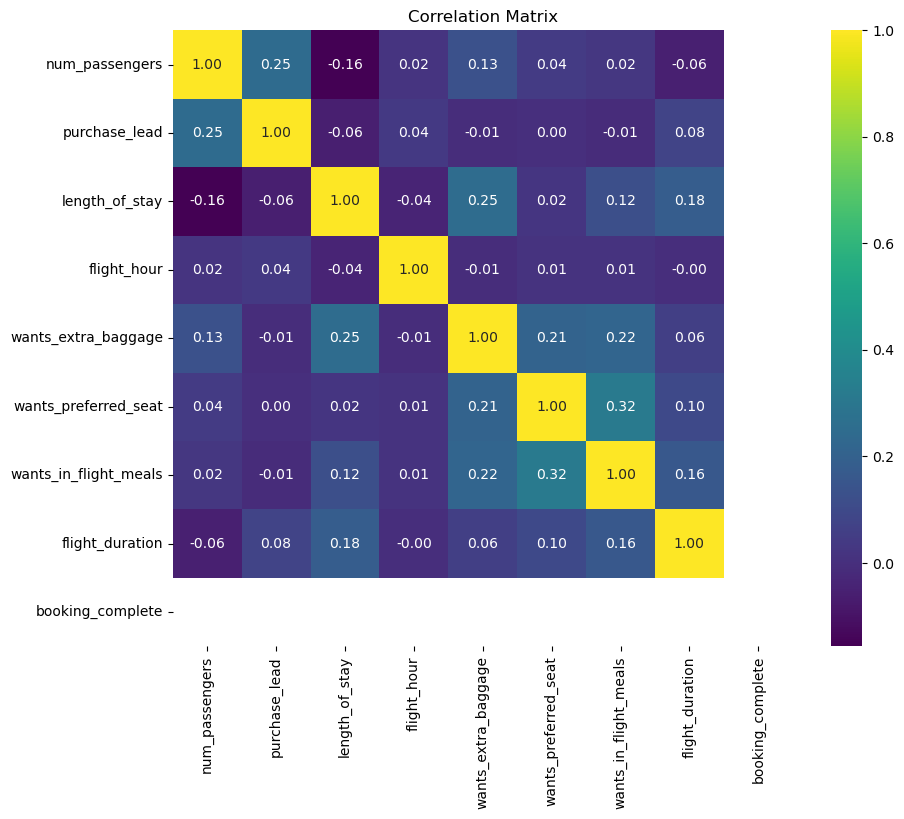

In [25]:
#HEATMAP

corr_matrix = df.corr(numeric_only=True)

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cbar=True, cmap="viridis")
plt.title("Correlation Matrix")
plt.show()

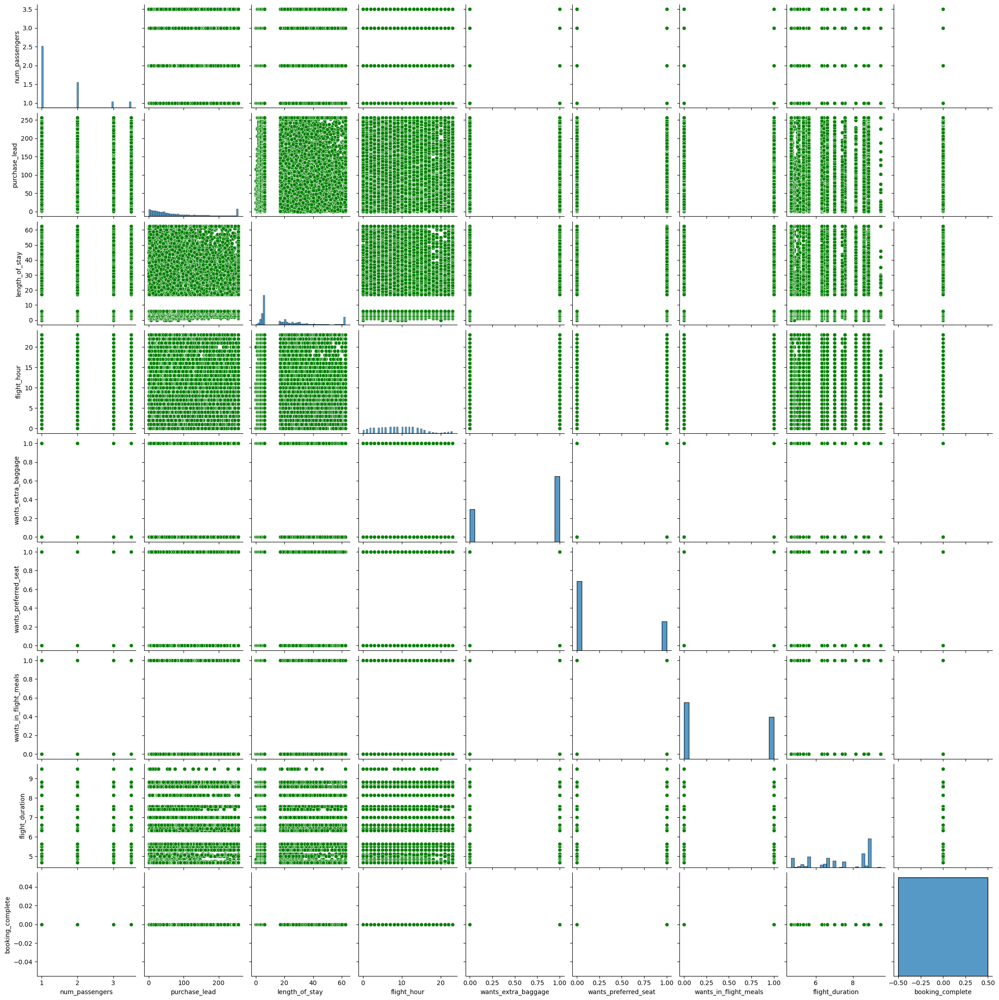

In [26]:
sns.pairplot(df, plot_kws={"color": "green"})
plt.show()

array([[<Axes: title={'center': 'num_passengers'}>,
        <Axes: title={'center': 'purchase_lead'}>,
        <Axes: title={'center': 'length_of_stay'}>],
       [<Axes: title={'center': 'flight_hour'}>,
        <Axes: title={'center': 'wants_extra_baggage'}>,
        <Axes: title={'center': 'wants_preferred_seat'}>],
       [<Axes: title={'center': 'wants_in_flight_meals'}>,
        <Axes: title={'center': 'flight_duration'}>,
        <Axes: title={'center': 'booking_complete'}>]], dtype=object)

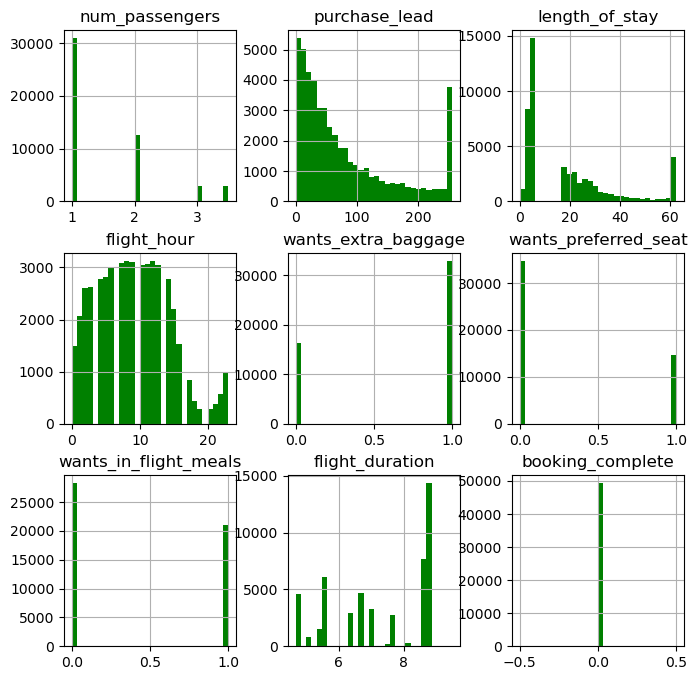

In [27]:
df.hist(bins=30, color="green", figsize=(8,8))

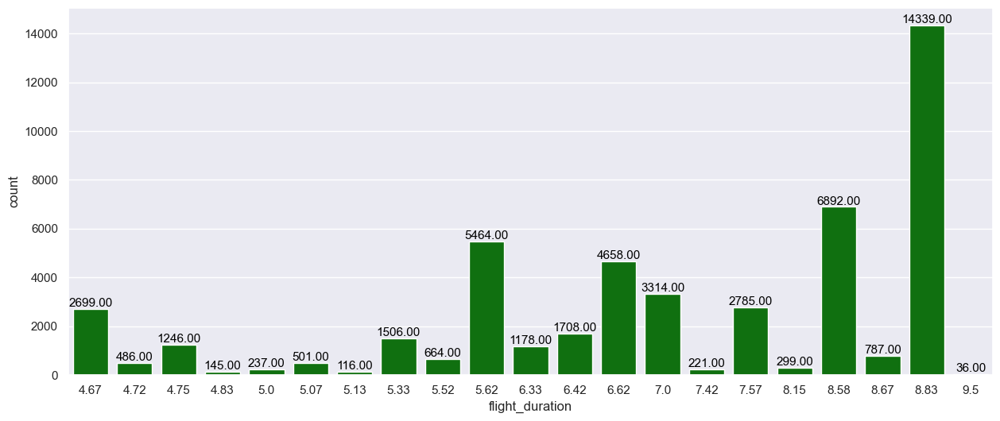

In [28]:
# İstifadəçilər tərəfindən seçilən ortalama uçuş müddəti

sns.set(style="darkgrid")
sns.set_palette("pastel")
plt.figure(figsize=(15,6))
sns.countplot(df, x="flight_duration", color="green")

ax = plt.gca()
for p in ax.patches:
    ax.annotate(f"{p.get_height():.2f}", (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                textcoords='offset points')

In [29]:
wants_extra_baggage_counts = df["wants_extra_baggage"].value_counts()
wants_extra_baggage_counts

wants_extra_baggage
1.0    32931
0.0    16350
Name: count, dtype: int64

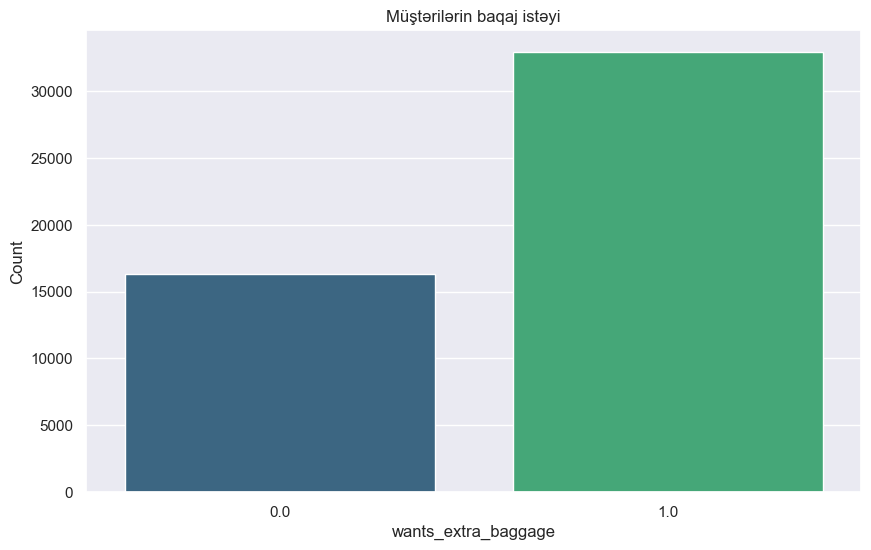

In [30]:
# Barplot

plt.figure(figsize=(10, 6))
sns.barplot(x=wants_extra_baggage_counts.index, y=wants_extra_baggage_counts.values, palette="viridis")

plt.xlabel("wants_extra_baggage")
plt.ylabel("Count")
plt.title("Müştərilərin baqaj istəyi")
plt.show()

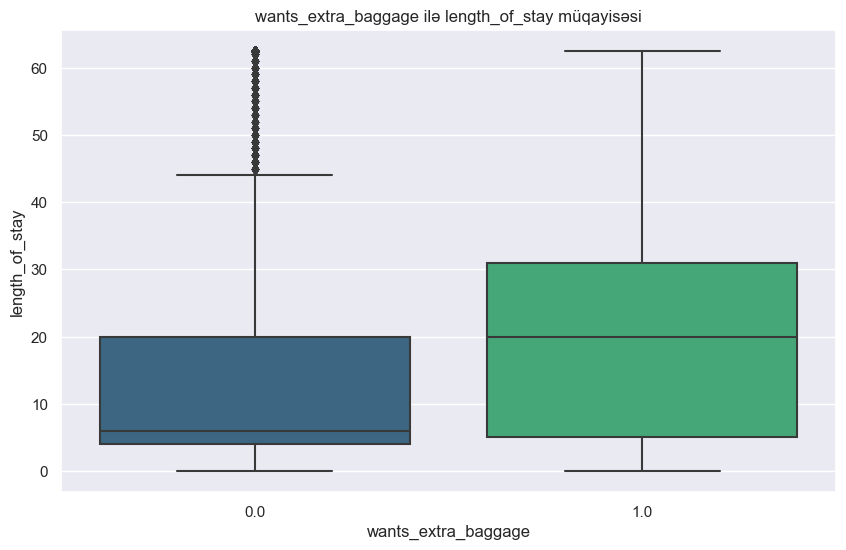

In [31]:
plt.figure(figsize=(10, 6))
sns.boxplot(x="wants_extra_baggage", y="length_of_stay", data=df, palette="viridis")
plt.xlabel("wants_extra_baggage")
plt.ylabel("length_of_stay")
plt.title("wants_extra_baggage ilə length_of_stay müqayisəsi")
plt.show()

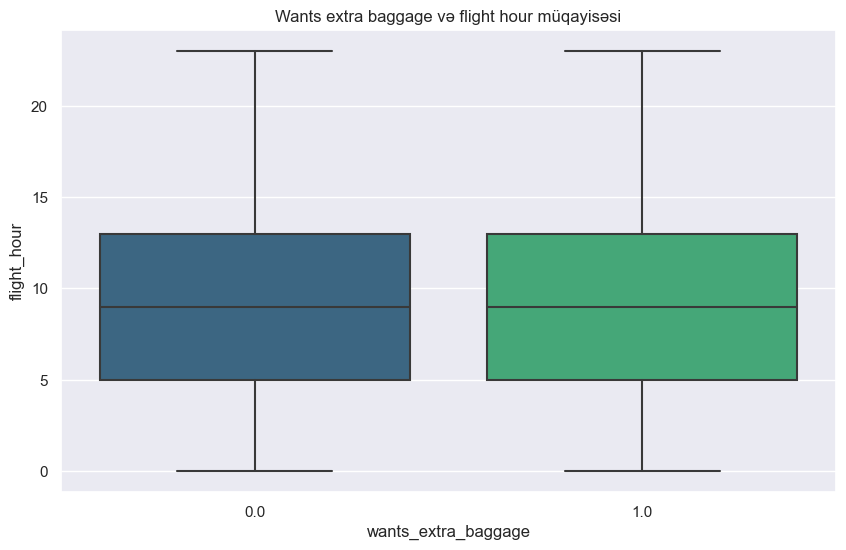

In [32]:
plt.figure(figsize=(10, 6))
sns.boxplot(x="wants_extra_baggage", y="flight_hour", data=df, palette="viridis")
plt.xlabel("wants_extra_baggage")
plt.ylabel("flight_hour")
plt.title("Wants extra baggage və flight hour müqayisəsi")
plt.show()

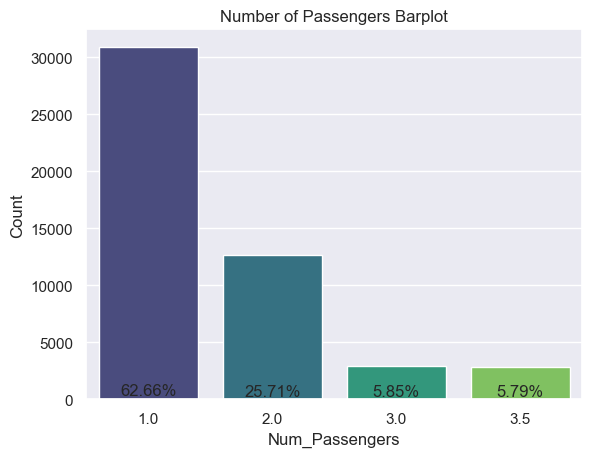

In [33]:
sns.barplot(x=df["num_passengers"].value_counts().index, y=df["num_passengers"].value_counts(), palette="viridis")

num_passengers_counts = df["num_passengers"].value_counts()

total_count = num_passengers_counts.sum()
percentages = num_passengers_counts / total_count * 100

for index, value in enumerate(percentages):
    plt.text(index, value + 0.5, f"{value:.2f}%", ha="center", va="bottom")

plt.xlabel("Num_Passengers")
plt.ylabel("Count")
plt.title("Number of Passengers Barplot")
plt.show()

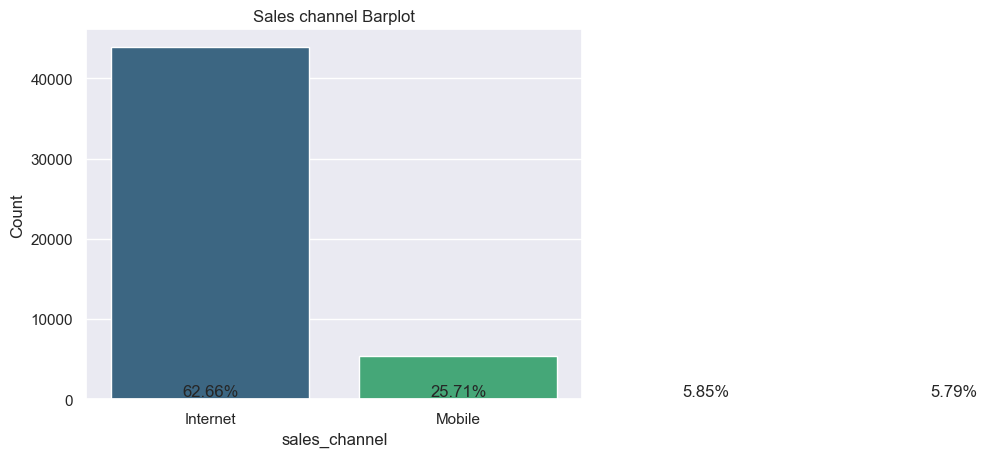

In [34]:
sns.barplot(x=df["sales_channel"].value_counts().index, y=df["sales_channel"].value_counts(), palette="viridis")


for index, value in enumerate(percentages):
    plt.text(index, value + 0.5, f"{value:.2f}%", ha="center", va="bottom")

plt.xlabel("sales_channel")
plt.ylabel("Count")
plt.title("Sales channel Barplot")
plt.show()

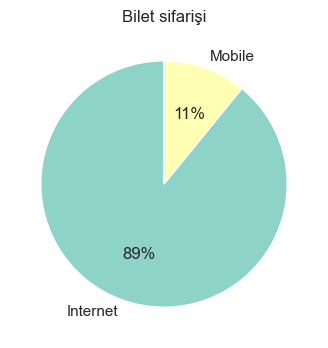

In [35]:
#sales chanel pie chart

category_counts = df["sales_channel"].value_counts()

# Create a pie chart
plt.figure(figsize=(4, 4))
plt.pie(category_counts, labels=category_counts.index, autopct="%.0f%%", 
        startangle=90, colors=plt.cm.Set3(range(len(category_counts))))
plt.title("Bilet sifarişi")
plt.show()

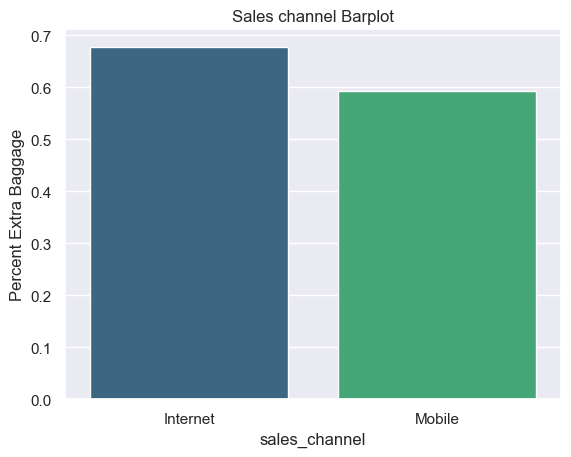

In [36]:
sns.barplot(x=df["sales_channel"], y=df["wants_extra_baggage"], palette="viridis", estimator="mean", errorbar=None)
plt.xlabel("sales_channel")
plt.ylabel("Percent Extra Baggage")
plt.title("Sales channel Barplot")
plt.show()

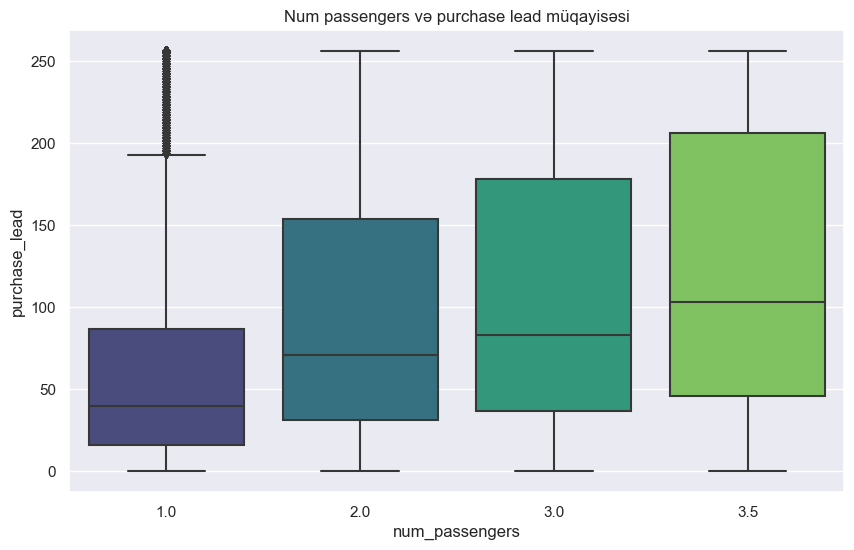

In [37]:
#???

plt.figure(figsize=(10, 6))
sns.boxplot(x="num_passengers", y="purchase_lead", data=df, palette="viridis")
plt.xlabel("num_passengers")
plt.ylabel("purchase_lead")
plt.title("Num passengers və purchase lead müqayisəsi")
plt.show()

In [38]:
df["trip_type"].value_counts()

trip_type
RoundTrip     48779
OneWay          386
CircleTrip      116
Name: count, dtype: int64

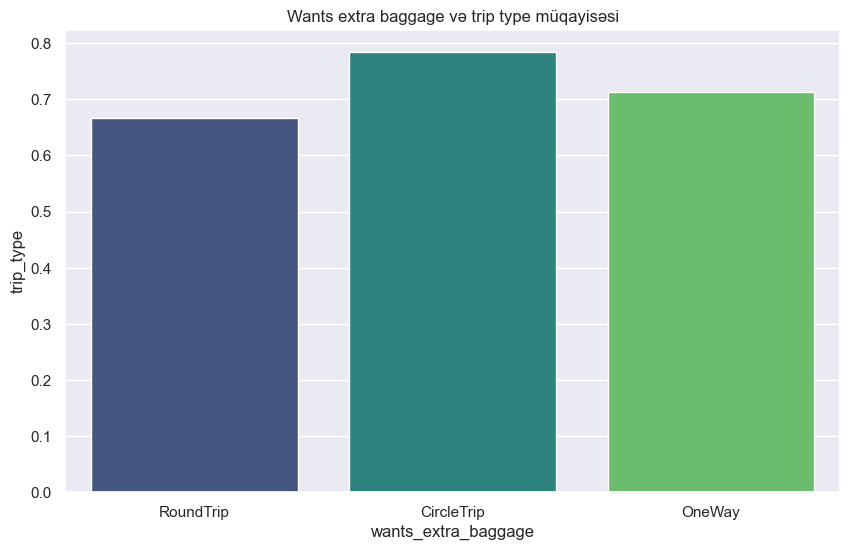

In [39]:
# Digər sütunlarla müqayisə üçün barplot

plt.figure(figsize=(10, 6))
sns.barplot(x="trip_type", y="wants_extra_baggage", estimator="mean", data=df, palette="viridis", errorbar=None)

plt.xlabel("wants_extra_baggage")
plt.ylabel("trip_type")
plt.title("Wants extra baggage və trip type müqayisəsi")
plt.show()

In [40]:
#Distribution of Users by Extra Baggage and Preferred Seat Selection

#fig = px.histogram(df, x="wants_extra_baggage", color="wants_preferred_seat",
                   #histfunc="count", nbins=len(df["wants_extra_baggage"].unique()),
                   #width=1000, height=600, color_discrete_map={"YES": "#2ca02c"})

#fig.update_layout(xaxis_title="İstifadəçilərin əlavə baqaj və üstünlük verilmiş oturacaq seçiminə görə paylanması",
                  #yaxis_title="Users", barmode="group")  
#fig.show()

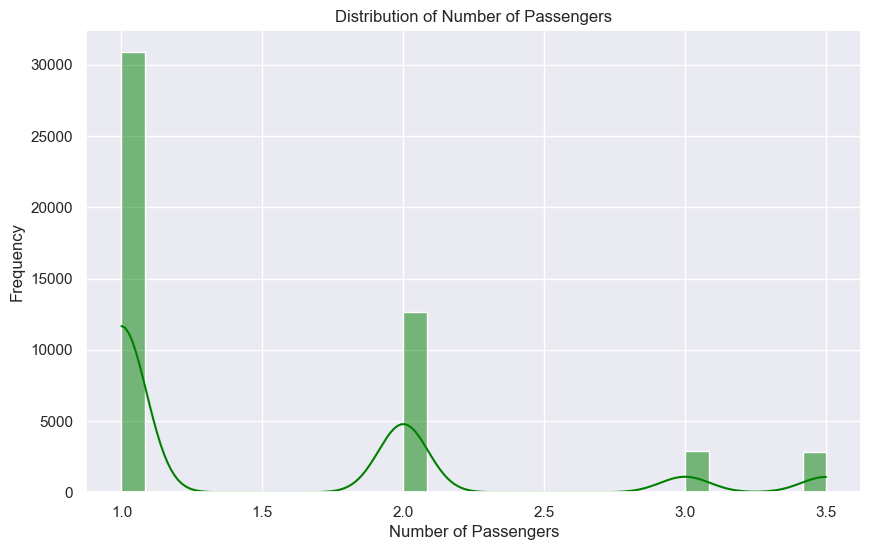

In [41]:
# Visualize distribution of number of passengers

plt.figure(figsize=(10, 6))
sns.histplot(df["num_passengers"], bins=30, kde=True, color="green")

plt.title("Distribution of Number of Passengers")
plt.xlabel("Number of Passengers")
plt.ylabel("Frequency")
plt.show()

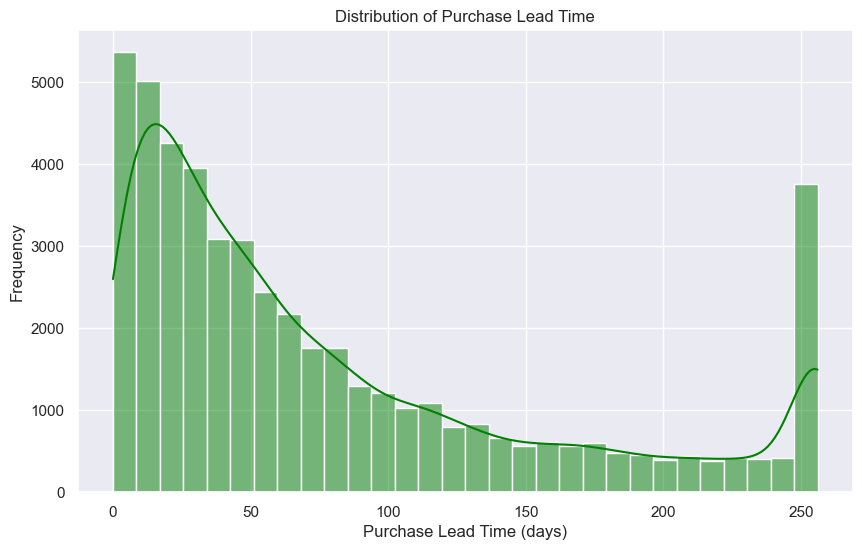

In [42]:
# Visualize distribution of purchase lead time

plt.figure(figsize=(10, 6))
sns.histplot(df["purchase_lead"], bins=30, kde=True, color="green")

plt.title("Distribution of Purchase Lead Time")
plt.xlabel("Purchase Lead Time (days)")
plt.ylabel("Frequency")
plt.show()


In [43]:
booking_origin_counts = df["booking_origin"].value_counts()
booking_origin_counts

booking_origin
Australia               17769
Malaysia                 7055
South Korea              4502
Japan                    3819
China                    3284
                        ...  
Panama                      1
Tonga                       1
Tanzania                    1
Bulgaria                    1
Svalbard & Jan Mayen        1
Name: count, Length: 103, dtype: int64

In [44]:
#Most Popular Booking Destinations

fig = px.pie(df, values="num_passengers", names="booking_origin",
              title="Ən Populyar Rezervasiya İstiqamətləri",
              hover_data=["sales_channel"], labels={"sales_channel":"Device"})
fig.update_traces(textposition="inside", textinfo="percent+label")
fig.update_layout(width=900, height=700)
fig.show()

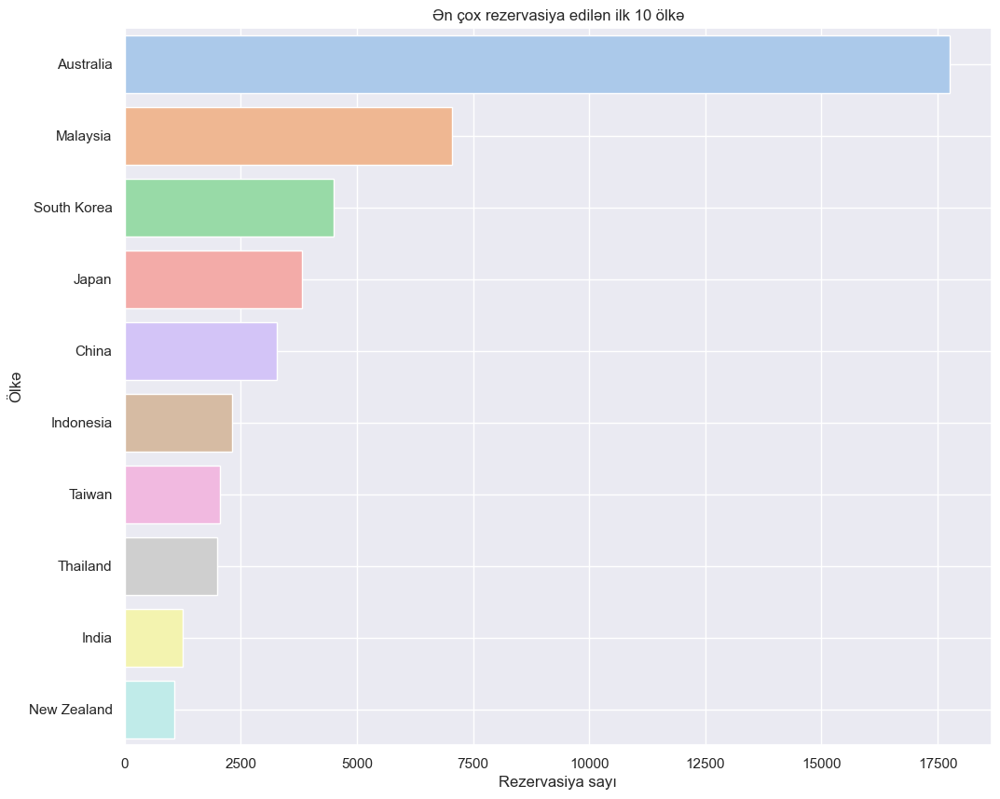

In [45]:
top_10_countries = df["booking_origin"].value_counts().head(10)

# Çubuq qrafiksinin hazırlanması
plt.figure(figsize=(12, 10))
sns.barplot(x=top_10_countries.values, y=top_10_countries.index, orient="h")

plt.title("Ən çox rezervasiya edilən ilk 10 ölkə")
plt.xlabel("Rezervasiya sayı")
plt.ylabel("Ölkə")
plt.grid(True)
plt.show()

In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 49281 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         49281 non-null  float64
 1   sales_channel          49281 non-null  object 
 2   trip_type              49281 non-null  object 
 3   purchase_lead          49281 non-null  float64
 4   length_of_stay         49281 non-null  float64
 5   flight_hour            49281 non-null  float64
 6   flight_day             49281 non-null  object 
 7   route                  49281 non-null  object 
 8   booking_origin         49281 non-null  object 
 9   wants_extra_baggage    49281 non-null  float64
 10  wants_preferred_seat   49281 non-null  float64
 11  wants_in_flight_meals  49281 non-null  float64
 12  flight_duration        49281 non-null  float64
 13  booking_complete       49281 non-null  float64
dtypes: float64(9), object(5)
memory usage: 5.6+ MB


In [47]:
for column in df.select_dtypes(include=["float"]):
    df[column] = df[column].astype(int)

In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 49281 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   num_passengers         49281 non-null  int32 
 1   sales_channel          49281 non-null  object
 2   trip_type              49281 non-null  object
 3   purchase_lead          49281 non-null  int32 
 4   length_of_stay         49281 non-null  int32 
 5   flight_hour            49281 non-null  int32 
 6   flight_day             49281 non-null  object
 7   route                  49281 non-null  object
 8   booking_origin         49281 non-null  object
 9   wants_extra_baggage    49281 non-null  int32 
 10  wants_preferred_seat   49281 non-null  int32 
 11  wants_in_flight_meals  49281 non-null  int32 
 12  flight_duration        49281 non-null  int32 
 13  booking_complete       49281 non-null  int32 
dtypes: int32(9), object(5)
memory usage: 3.9+ MB


# ENCODING

In [49]:
df.drop("route",axis=1,inplace=True)

In [50]:
air_df = pd.get_dummies(df, columns=["sales_channel", "trip_type", "flight_day", "booking_origin"], drop_first = True)

In [51]:
air_df

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete,sales_channel_Mobile,...,booking_origin_Timor-Leste,booking_origin_Tonga,booking_origin_Tunisia,booking_origin_Turkey,booking_origin_Ukraine,booking_origin_United Arab Emirates,booking_origin_United Kingdom,booking_origin_United States,booking_origin_Vanuatu,booking_origin_Vietnam
0,2,256,19,7,1,0,0,5,0,False,...,False,False,False,False,False,False,False,False,False,False
1,1,112,20,3,0,0,0,5,0,False,...,False,False,False,False,False,False,False,False,False,False
2,2,243,22,17,1,1,0,5,0,False,...,False,False,False,False,False,False,False,False,False,False
3,1,96,31,4,0,0,1,5,0,False,...,False,False,False,False,False,False,False,False,False,False
4,2,68,22,15,1,0,1,5,0,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,27,6,9,1,0,1,5,0,False,...,False,False,False,False,False,False,False,False,False,False
49996,1,111,6,4,0,0,0,5,0,False,...,False,False,False,False,False,False,False,False,False,False
49997,1,24,6,22,0,0,1,5,0,False,...,False,False,False,False,False,False,False,False,False,False
49998,1,15,6,11,1,0,1,5,0,False,...,False,False,False,False,False,False,False,False,False,False


In [52]:
air_df.wants_extra_baggage

0        1
1        0
2        1
3        0
4        1
        ..
49995    1
49996    0
49997    0
49998    1
49999    0
Name: wants_extra_baggage, Length: 49281, dtype: int32

# SPLITING

In [53]:
X = air_df.drop(columns=["wants_extra_baggage"])
y = air_df["wants_extra_baggage"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [54]:
X_train

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete,sales_channel_Mobile,trip_type_OneWay,...,booking_origin_Timor-Leste,booking_origin_Tonga,booking_origin_Tunisia,booking_origin_Turkey,booking_origin_Ukraine,booking_origin_United Arab Emirates,booking_origin_United Kingdom,booking_origin_United States,booking_origin_Vanuatu,booking_origin_Vietnam
32040,3,69,4,1,0,0,6,0,False,False,...,False,False,False,False,False,False,False,False,False,False
16012,2,126,17,3,0,0,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
41827,2,20,5,23,0,0,5,0,False,False,...,False,False,False,False,False,False,False,False,False,False
8656,1,25,28,8,0,0,5,0,False,False,...,False,False,False,False,False,False,False,False,False,False
6110,3,231,62,13,0,1,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11435,2,3,52,23,0,0,5,0,False,False,...,False,False,False,False,False,False,False,False,False,False
45357,1,19,6,22,0,0,7,0,False,False,...,False,False,False,False,False,False,False,False,False,False
38667,3,43,5,10,0,0,7,0,False,False,...,False,False,False,False,False,False,False,False,False,False
874,2,256,22,14,0,1,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False


In [55]:
X_test

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete,sales_channel_Mobile,trip_type_OneWay,...,booking_origin_Timor-Leste,booking_origin_Tonga,booking_origin_Tunisia,booking_origin_Turkey,booking_origin_Ukraine,booking_origin_United Arab Emirates,booking_origin_United Kingdom,booking_origin_United States,booking_origin_Vanuatu,booking_origin_Vietnam
18711,1,33,37,14,0,1,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
42436,2,4,6,15,0,0,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
6588,1,6,24,12,0,1,5,0,False,False,...,False,False,False,False,False,False,False,False,False,False
21148,1,22,62,4,0,1,5,0,False,False,...,False,False,False,False,False,False,False,False,False,False
4012,1,7,18,9,1,0,7,0,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3956,1,16,17,6,0,1,9,0,False,False,...,False,False,False,False,False,False,False,False,False,False
6975,2,82,55,8,1,1,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
7137,1,112,29,23,1,1,8,0,False,False,...,False,False,False,False,False,False,False,False,False,False
26082,1,256,2,17,0,0,6,0,False,False,...,False,False,False,False,False,False,False,False,False,False


In [56]:
print(f"X_train shape: {X_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (39424, 119)
X_test shape: (9857, 119)
y_train shape: (39424,)
y_test shape: (9857,)


# SCAILING

In [57]:
# Standartlaşdırma 

scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [58]:
X_train = pd.DataFrame(X_train)
X_train.columns = air_df.drop("wants_extra_baggage", axis=1).columns

In [59]:
X_train

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete,sales_channel_Mobile,trip_type_OneWay,...,booking_origin_Timor-Leste,booking_origin_Tonga,booking_origin_Tunisia,booking_origin_Turkey,booking_origin_Ukraine,booking_origin_United Arab Emirates,booking_origin_United Kingdom,booking_origin_United States,booking_origin_Vanuatu,booking_origin_Vietnam
0,2.170113,-0.137651,-0.841391,-1.491035,-0.646748,-0.861906,-0.475246,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
1,0.732898,0.606790,-0.128138,-1.121325,-0.646748,-0.861906,0.928839,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
2,0.732898,-0.777609,-0.786525,2.575773,-0.646748,-0.861906,-1.177289,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
3,-0.704317,-0.712307,0.475384,-0.197051,-0.646748,-0.861906,-1.177289,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
4,2.170113,1.978129,2.340816,0.727224,-0.646748,1.160219,0.928839,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39419,0.732898,-0.999635,1.792159,2.575773,-0.646748,-0.861906,-1.177289,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
39420,-0.704317,-0.790669,-0.731660,2.390918,-0.646748,-0.861906,0.226796,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
39421,2.170113,-0.477220,-0.786525,0.172659,-0.646748,-0.861906,0.226796,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007
39422,0.732898,2.304639,0.146191,0.912079,-0.646748,1.160219,0.928839,0.0,-0.347466,-0.090888,...,-0.007123,-0.005036,-0.007123,-0.012338,-0.010073,-0.028944,-0.058618,-0.096936,-0.005036,-0.088007


In [60]:
X_test

array([[-0.70431698, -0.60782405,  0.96917492, ..., -0.09693566,
        -0.00503646, -0.08800682],
       [ 0.73289795, -0.98657482, -0.73165953, ..., -0.09693566,
        -0.00503646, -0.08800682],
       [-0.70431698, -0.96045407,  0.25592177, ..., -0.09693566,
        -0.00503646, -0.08800682],
       ...,
       [-0.70431698,  0.42394527,  0.5302499 , ..., -0.09693566,
        -0.00503646, -0.08800682],
       [-0.70431698,  2.30463871, -0.95112204, ..., -0.09693566,
        -0.00503646, -0.08800682],
       [ 2.17011288, -0.359677  , -0.073272  , ..., -0.09693566,
        -0.00503646, -0.08800682]])

# MODELS

# DecisionTree

In [61]:
from sklearn.metrics import roc_curve, roc_auc_score

In [62]:
# Decision Tree modelinin yaradılması və təlim edilməsi
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)

# Təlim dəstəsi üzərində proqnozlar
y_pred_dt_train = dt.predict(X_train)

# Test dəstəsi üzərində proqnozlar
y_pred_dt_test = dt.predict(X_test)

# Təlim dəstəsi üçün performans metriklərinin hesablanması
accuracy_dt_train = accuracy_score(y_train, y_pred_dt_train)
precision_dt_train = precision_score(y_train, y_pred_dt_train)
recall_dt_train = recall_score(y_train, y_pred_dt_train)
f1_dt_train = f1_score(y_train, y_pred_dt_train, average="macro")
roc_auc_dt_train = roc_auc_score(y_train, y_pred_dt_train)

# Test dəstəsi üçün performans metriklərinin hesablanması
accuracy_dt_test = accuracy_score(y_test, y_pred_dt_test)
precision_dt_test = precision_score(y_test, y_pred_dt_test)
recall_dt_test = recall_score(y_test, y_pred_dt_test)
f1_dt_test = f1_score(y_test, y_pred_dt_test, average="macro")
roc_auc_dt_test = roc_auc_score(y_test, y_pred_dt_test)

# Nəticələrin çap edilməsi
print("Train Metrics:")
print(f"Decision Tree Train Accuracy: {accuracy_dt_train:.2f}")
print(f"Decision Tree Train Precision: {precision_dt_train:.2f}")
print(f"Decision Tree Train Recall: {recall_dt_train:.2f}")
print(f"Decision Tree Train F1 Score (macro): {f1_dt_train:.2f}")
print(f"Decision Tree Train ROC-AUC: {roc_auc_dt_train:.2f}")

print("\nTest Metrics:")
print(f"Decision Tree Test Accuracy: {accuracy_dt_test:.2f}")
print(f"Decision Tree Test Precision: {precision_dt_test:.2f}")
print(f"Decision Tree Test Recall: {recall_dt_test:.2f}")
print(f"Decision Tree Test F1 Score (macro): {f1_dt_test:.2f}")
print(f"Decision Tree Test ROC-AUC: {roc_auc_dt_test:.2f}")

Train Metrics:
Decision Tree Train Accuracy: 1.00
Decision Tree Train Precision: 1.00
Decision Tree Train Recall: 1.00
Decision Tree Train F1 Score (macro): 1.00
Decision Tree Train ROC-AUC: 1.00

Test Metrics:
Decision Tree Test Accuracy: 0.65
Decision Tree Test Precision: 0.73
Decision Tree Test Recall: 0.73
Decision Tree Test F1 Score (macro): 0.60
Decision Tree Test ROC-AUC: 0.61


# Logistic Regression

In [63]:
# Logistic Regression modelinin yaradılması və təlim edilməsi
log_r = LogisticRegression()
log_r.fit(X_train, y_train)

# Təlim dəstəsi üzərində proqnozlar
y_pred_log_r_train = log_r.predict(X_train)

# Test dəstəsi üzərində proqnozlar
y_pred_log_r_test = log_r.predict(X_test)

# Təlim dəstəsi üçün performans metriklərinin hesablanması
accuracy_log_r_train = accuracy_score(y_train, y_pred_log_r_train)
precision_log_r_train = precision_score(y_train, y_pred_log_r_train)
recall_log_r_train = recall_score(y_train, y_pred_log_r_train)
f1_log_r_train = f1_score(y_train, y_pred_log_r_train, average="macro")
roc_auc_log_r_train = roc_auc_score(y_train, y_pred_log_r_train)

# Test dəstəsi üçün performans metriklərinin hesablanması
accuracy_log_r_test = accuracy_score(y_test, y_pred_log_r_test)
precision_log_r_test = precision_score(y_test, y_pred_log_r_test)
recall_log_r_test = recall_score(y_test, y_pred_log_r_test)
f1_log_r_test = f1_score(y_test, y_pred_log_r_test, average="macro")
roc_auc_log_r_test = roc_auc_score(y_test, y_pred_log_r_test)

# Nəticələrin çap edilməsi
print("Train Metrics:")
print(f"Logistic Regression Train Accuracy: {accuracy_log_r_train:.2f}")
print(f"Logistic Regression Train Precision: {precision_log_r_train:.2f}")
print(f"Logistic Regression Train Recall: {recall_log_r_train:.2f}")
print(f"Logistic Regression Train F1 Score (macro): {f1_log_r_train:.2f}")
print(f"Logistic Regression Train ROC-AUC: {roc_auc_log_r_train:.2f}")

print("\nTest Metrics:")
print(f"Logistic Regression Test Accuracy: {accuracy_log_r_test:.2f}")
print(f"Logistic Regression Test Precision: {precision_log_r_test:.2f}")
print(f"Logistic Regression Test Recall: {recall_log_r_test:.2f}")
print(f"Logistic Regression Test F1 Score (macro): {f1_log_r_test:.2f}")
print(f"Logistic Regression Test ROC-AUC: {roc_auc_log_r_test:.2f}")

Train Metrics:
Logistic Regression Train Accuracy: 0.72
Logistic Regression Train Precision: 0.75
Logistic Regression Train Recall: 0.87
Logistic Regression Train F1 Score (macro): 0.65
Logistic Regression Train ROC-AUC: 0.64

Test Metrics:
Logistic Regression Test Accuracy: 0.72
Logistic Regression Test Precision: 0.75
Logistic Regression Test Recall: 0.87
Logistic Regression Test F1 Score (macro): 0.65
Logistic Regression Test ROC-AUC: 0.64


# Support Vector Machine (SVM)

In [64]:
# SVM modelinin yaratılması
svm = SVC()

# SVM modelinin eğitilmesi
svm.fit(X_train, y_train)

# Eğitim veri kümesi üzerinde tahminlerin yapılması
y_pred_svm_train = svm.predict(X_train)

# Test veri kümesi üzerinde tahminlerin yapılması
y_pred_svm_test = svm.predict(X_test)

# Eğitim performans metriklerinin hesaplanması
accuracy_svm_train = accuracy_score(y_train, y_pred_svm_train)
f1_svm_train = f1_score(y_train, y_pred_svm_train, average="macro")
roc_auc_svm_train = roc_auc_score(y_train, y_pred_svm_train)

# Test performans metriklerinin hesaplanması
accuracy_svm_test = accuracy_score(y_test, y_pred_svm_test)
f1_svm_test = f1_score(y_test, y_pred_svm_test, average="macro")
roc_auc_svm_test = roc_auc_score(y_test, y_pred_svm_test)

# Sonuçların yazdırılması
print("Train Metrics:")
print(f"SVM Train Accuracy: {accuracy_svm_train:.2f}")
print(f"SVM Train F1 Score (macro): {f1_svm_train:.2f}")
print(f"SVM Train ROC-AUC: {roc_auc_svm_train:.2f}")

print("\nTest Metrics:")
print(f"SVM Test Accuracy: {accuracy_svm_test:.2f}")
print(f"SVM Test F1 Score (macro): {f1_svm_test:.2f}")
print(f"SVM Test ROC-AUC: {roc_auc_svm_test:.2f}")

Train Metrics:
SVM Train Accuracy: 0.72
SVM Train F1 Score (macro): 0.64
SVM Train ROC-AUC: 0.63

Test Metrics:
SVM Test Accuracy: 0.72
SVM Test F1 Score (macro): 0.64
SVM Test ROC-AUC: 0.63


# BAGGİNG

# Random Forest

In [65]:
# RF modelinin yaratılması
rf_model = RandomForestClassifier(random_state=42)

# RF modelinin eğitilmesi
rf_model.fit(X_train, y_train)

# Eğitim veri kümesi üzerinde tahminlerin yapılması
y_pred_rf_train = rf_model.predict(X_train)

# Test veri kümesi üzerinde tahminlerin yapılması
y_pred_rf_test = rf_model.predict(X_test)

# Eğitim performans metriklerinin hesaplanması
accuracy_rf_train = accuracy_score(y_train, y_pred_rf_train)
f1_rf_train = f1_score(y_train, y_pred_rf_train, average="macro")
roc_auc_rf_train = roc_auc_score(y_train, y_pred_rf_train)

# Test performans metriklerinin hesaplanması
accuracy_rf_test = accuracy_score(y_test, y_pred_rf_test)
f1_rf_test = f1_score(y_test, y_pred_rf_test, average="macro")
roc_auc_rf_test = roc_auc_score(y_test, y_pred_rf_test)

# Sonuçların yazdırılması
print("Train Metrics:")
print(f"Random Forest Train Accuracy: {accuracy_rf_train:.2f}")
print(f"Random Forest Train F1 Score (macro): {f1_rf_train:.2f}")
print(f"Random Forest Train ROC-AUC: {roc_auc_rf_train:.2f}")

print("\nTest Metrics:")
print(f"Random Forest Test Accuracy: {accuracy_rf_test:.2f}")
print(f"Random Forest Test F1 Score (macro): {f1_rf_test:.2f}")
print(f"Random Forest Test ROC-AUC: {roc_auc_rf_test:.2f}")

Train Metrics:
Random Forest Train Accuracy: 1.00
Random Forest Train F1 Score (macro): 1.00
Random Forest Train ROC-AUC: 1.00

Test Metrics:
Random Forest Test Accuracy: 0.71
Random Forest Test F1 Score (macro): 0.65
Random Forest Test ROC-AUC: 0.64


# BOOSTİNG

# XGBoost

In [66]:
!pip install xgboost
from xgboost import XGBClassifier
import xgboost as xgb

In [67]:
# XGB modelinin yaratılması
xgb_model = xgb.XGBClassifier(random_state=42)

# XGB modelinin eğitilmesi
xgb_model.fit(X_train, y_train)

# Eğitim veri kümesi üzerinde tahminlerin yapılması
y_pred_train = xgb_model.predict(X_train)

# Test veri kümesi üzerinde tahminlerin yapılması
y_pred_test = xgb_model.predict(X_test)

# Eğitim performans metriklerinin hesaplanması
accuracy_train = accuracy_score(y_train, y_pred_train)
f1_train = f1_score(y_train, y_pred_train, average="macro")
roc_auc_train = roc_auc_score(y_train, y_pred_train)

# Test performans metriklerinin hesaplanması
accuracy_test = accuracy_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test, average="macro")
roc_auc_test = roc_auc_score(y_test, y_pred_test)

# Sonuçların yazdırılması
print("Train Metrics:")
print(f"XGBoost Train Accuracy: {accuracy_train:.2f}")
print(f"XGBoost Train F1 Score (macro): {f1_train:.2f}")
print(f"XGBoost Train ROC-AUC: {roc_auc_train:.2f}")

print("\nTest Metrics:")
print(f"XGBoost Test Accuracy: {accuracy_test:.2f}")
print(f"XGBoost Test F1 Score (macro): {f1_test:.2f}")
print(f"XGBoost Test ROC-AUC: {roc_auc_test:.2f}")

Train Metrics:
XGBoost Train Accuracy: 0.77
XGBoost Train F1 Score (macro): 0.72
XGBoost Train ROC-AUC: 0.71

Test Metrics:
XGBoost Test Accuracy: 0.73
XGBoost Test F1 Score (macro): 0.67
XGBoost Test ROC-AUC: 0.67


# LightGBM

In [68]:
!pip install lightgbm

In [69]:
import lightgbm as lgb

In [70]:
# LGB modelinin yaratılması
lgb_model = lgb.LGBMClassifier(random_state=42)

# LGB modelinin eğitilmesi
lgb_model.fit(X_train, y_train)

# Eğitim veri kümesi üzerinde tahminlerin yapılması
y_pred_train = lgb_model.predict(X_train)

# Test veri kümesi üzerinde tahminlerin yapılması
y_pred_test = lgb_model.predict(X_test)

# Eğitim performans metriklerinin hesaplanması
accuracy_train = accuracy_score(y_train, y_pred_train)
f1_train = f1_score(y_train, y_pred_train, average="macro")
roc_auc_train = roc_auc_score(y_train, y_pred_train)

# Test performans metriklerinin hesaplanması
accuracy_test = accuracy_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test, average="macro")
roc_auc_test = roc_auc_score(y_test, y_pred_test)

# Sonuçların yazdırılması
print("Train Metrics:")
print(f"LightGBM Train Accuracy: {accuracy_train:.2f}")
print(f"LightGBM Train F1 Score (macro): {f1_train:.2f}")
print(f"LightGBM Train ROC-AUC: {roc_auc_train:.2f}")

print("\nTest Metrics:")
print(f"LightGBM Test Accuracy: {accuracy_test:.2f}")
print(f"LightGBM Test F1 Score (macro): {f1_test:.2f}")
print(f"LightGBM Test ROC-AUC: {roc_auc_test:.2f}")

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 26403, number of negative: 13021
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018503 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 473
[LightGBM] [Info] Number of data points in the train set: 39424, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.669719 -> initscore=0.706914
[LightGBM] [Info] Start training from score 0.706914
Train Metrics:
LightGBM Train Accuracy: 0.75
LightGBM Train F1 Score (macro): 0.69
LightGBM Train ROC-AUC: 0.68

Test Metrics:
LightGBM Test Accuracy: 0.74
LightGBM Test F1 Score (macro): 0.68
LightGBM Test ROC-AUC: 0.67


# BEST MODEL - LightGBM

# Feature Importance

In [71]:
def plot_importances(model, X):
    
    importances = model.feature_importances_

    feature_importances = pd.DataFrame(importances, index=X.columns, columns=["importance"])

    feature_importances_sorted = feature_importances.sort_values(by="importance", ascending=False)

    plt.figure(figsize=(10, 10))
    sns.barplot(x="importance", y=feature_importances_sorted.index, data=feature_importances_sorted)
    plt.title("Feature Importances")
    plt.xlabel("Importance")
    plt.ylabel("Features")
    plt.show()
    return feature_importances_sorted

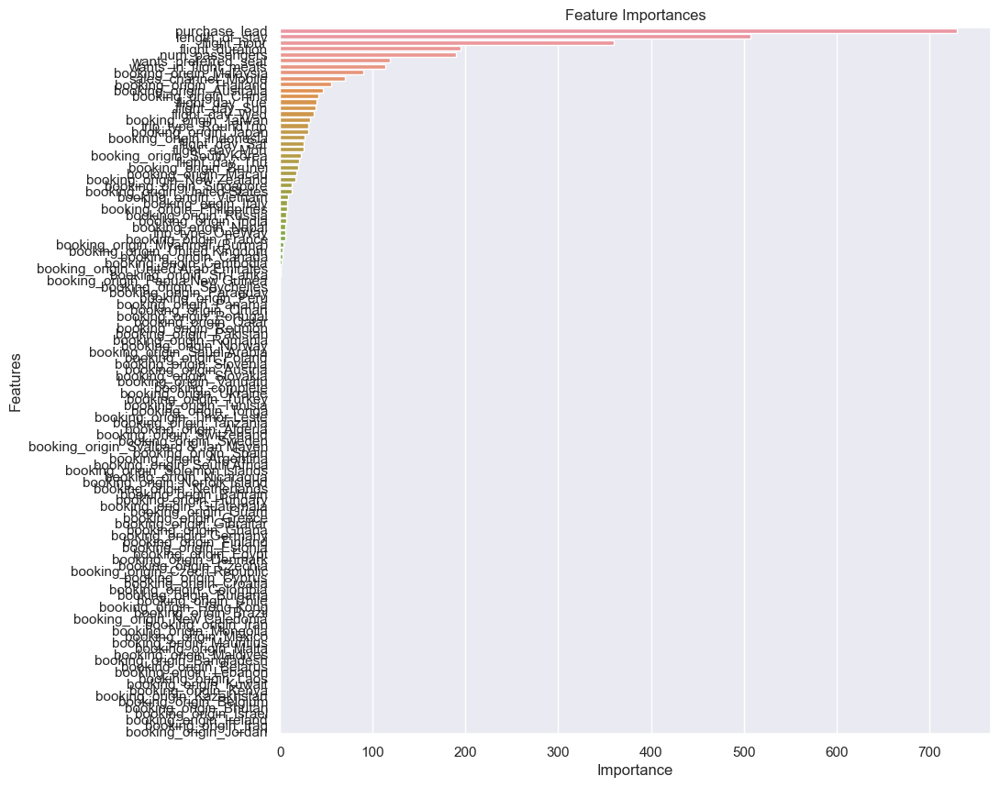

In [72]:
imps = plot_importances(lgb_model, X_train)

In [73]:
selected_columns = imps[imps.importance!=0]
selected_columns

,importance
purchase_lead,730
length_of_stay,507
flight_hour,360
flight_duration,195
num_passengers,190
wants_preferred_seat,119
wants_in_flight_meals,114
booking_origin_Malaysia,90
sales_channel_Mobile,70
booking_origin_Thailand,55


In [74]:
imp_columns = list(selected_columns.index)

In [75]:
X_train_new = X_train[imp_columns]

In [76]:
X_test_new = pd.DataFrame(X_test)
X_test_new.columns = X_train.columns

X_test_new = X_test_new[imp_columns]

X_test_new

,purchase_lead,length_of_stay,flight_hour,flight_duration,num_passengers,wants_preferred_seat,wants_in_flight_meals,booking_origin_Malaysia,sales_channel_Mobile,booking_origin_Thailand,...,booking_origin_India,booking_origin_Nepal,trip_type_OneWay,booking_origin_France,booking_origin_Myanmar (Burma),booking_origin_United Kingdom,booking_origin_Canada,booking_origin_Cambodia,booking_origin_United Arab Emirates,booking_origin_Sri Lanka
0,-0.607824,0.969175,0.912079,0.928839,-0.704317,-0.646748,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
1,-0.986575,-0.731660,1.096934,0.928839,0.732898,-0.646748,-0.861906,2.440397,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
2,-0.960454,0.255922,0.542369,-1.177289,-0.704317,-0.646748,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
3,-0.751488,2.340816,-0.936470,-1.177289,-0.704317,-0.646748,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
4,-0.947394,-0.073272,-0.012196,0.226796,-0.704317,1.546198,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9852,-0.829850,-0.128138,-0.566761,1.630882,-0.704317,-0.646748,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
9853,0.032134,1.956756,-0.197051,0.928839,0.732898,1.546198,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
9854,0.423945,0.530250,2.575773,0.928839,-0.704317,1.546198,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
9855,2.304639,-0.951122,1.466643,-0.475246,-0.704317,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384


In [77]:
X_train_new

,purchase_lead,length_of_stay,flight_hour,flight_duration,num_passengers,wants_preferred_seat,wants_in_flight_meals,booking_origin_Malaysia,sales_channel_Mobile,booking_origin_Thailand,...,booking_origin_India,booking_origin_Nepal,trip_type_OneWay,booking_origin_France,booking_origin_Myanmar (Burma),booking_origin_United Kingdom,booking_origin_Canada,booking_origin_Cambodia,booking_origin_United Arab Emirates,booking_origin_Sri Lanka
0,-0.137651,-0.841391,-1.491035,-0.475246,2.170113,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
1,0.606790,-0.128138,-1.121325,0.928839,0.732898,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
2,-0.777609,-0.786525,2.575773,-1.177289,0.732898,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
3,-0.712307,0.475384,-0.197051,-1.177289,-0.704317,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
4,1.978129,2.340816,0.727224,0.928839,2.170113,-0.646748,1.160219,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39419,-0.999635,1.792159,2.575773,-1.177289,0.732898,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
39420,-0.790669,-0.731660,2.390918,0.226796,-0.704317,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
39421,-0.477220,-0.786525,0.172659,0.226796,2.170113,-0.646748,-0.861906,-0.409769,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384
39422,2.304639,0.146191,0.912079,0.928839,0.732898,-0.646748,1.160219,2.440397,-0.347466,-0.205739,...,-0.164198,-0.027132,-0.090888,-0.033426,-0.032265,-0.058618,-0.03599,-0.052412,-0.028944,-0.038384


# LightGBM model in new parameter

In [78]:
# XGBoost ilə təlim edilmiş modelin yaradılması
lgb_model_new = lgb.LGBMClassifier(random_state=42)

# Yeni təlim dəstələri ilə modelin təlim edilməsi
lgb_model_new.fit(X_train_new, y_train)

# Test dəstəsi üzərində proqnozlar
y_pred_lgb_new = lgb_model_new.predict(X_test_new)

# Performans metriklərinin hesablanması
accuracy_lgb_new = accuracy_score(y_test, y_pred_lgb_new)
f1_lgb_new = f1_score(y_test, y_pred_lgb_new, average="macro")

# Nəticələrin çap edilməsi
print(f"LightGBM New Accuracy: {accuracy_lgb_new:.2f}")
print(f"LightGBM New F1 Score (macro): {f1_lgb_new:.2f}")

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 26403, number of negative: 13021
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011346 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 449
[LightGBM] [Info] Number of data points in the train set: 39424, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.669719 -> initscore=0.706914
[LightGBM] [Info] Start training from score 0.706914
LightGBM New Accuracy: 0.74
LightGBM New F1 Score (macro): 0.68


In [79]:
def plot_importances(model, X):
    
    importances = model.feature_importances_

    feature_importances = pd.DataFrame(importances, index=X.columns, columns=["importance"])

    feature_importances_sorted = feature_importances.sort_values(by="importance", ascending=False)

    plt.figure(figsize=(10, 10))
    sns.barplot(x="importance", y=feature_importances_sorted.index, data=feature_importances_sorted)
    plt.title("Feature Importances")
    plt.xlabel("Importance")
    plt.ylabel("Features")
    plt.show()
    return feature_importances_sorted

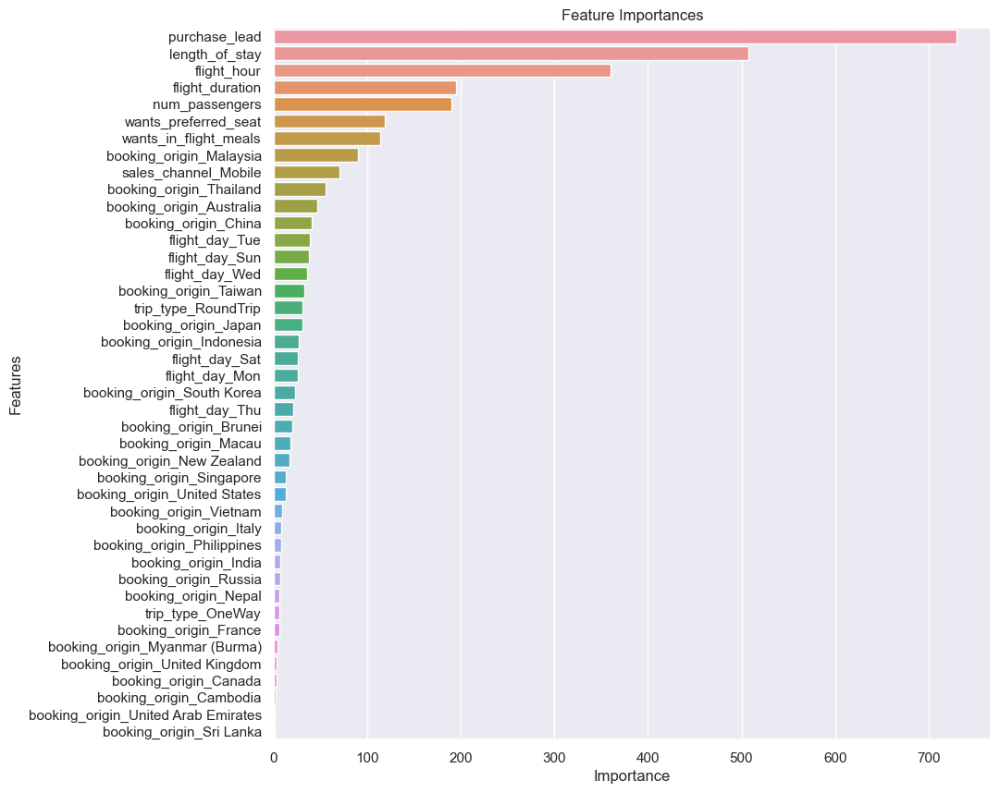

In [80]:
imps = plot_importances(lgb_model_new, X_train_new)

# MODEL EVALUATİON

# Roc Auc

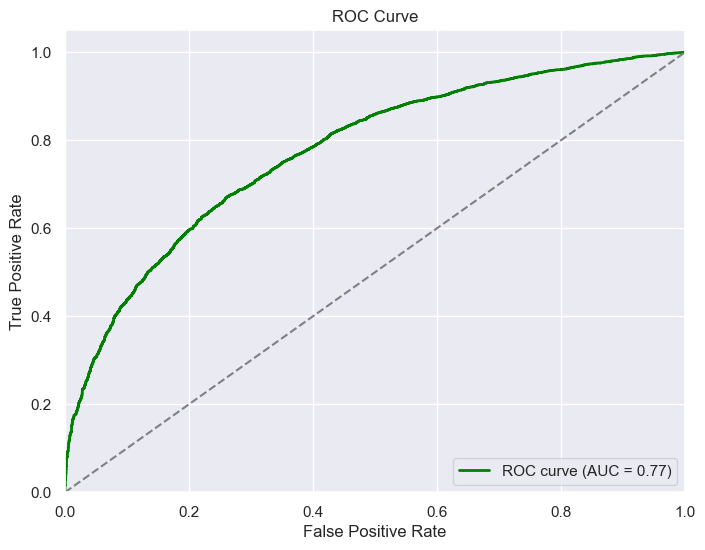

AUC Score: 0.77


In [81]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Test seti üzerinde tahminler yapma
y_pred_proba = lgb_model_new.predict_proba(X_test_new)[:, 1]

# ROC eğrisi ve AUC skoru hesaplama
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

# ROC eğrisini çizme
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color="green", lw=2, label="ROC curve (AUC = %0.2f)" % roc_auc)
plt.plot([0, 1], [0, 1], color="gray", linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend(loc="lower right")
plt.show()

# AUC skorunu ekrana yazdırma
print(f"AUC Score: {roc_auc:.2f}")

# Confusion matrix

In [82]:
from sklearn.metrics import confusion_matrix

In [83]:
cm = confusion_matrix(y_pred_lgb_new, y_test)
cm

array([[1537,  805],
       [1792, 5723]], dtype=int64)

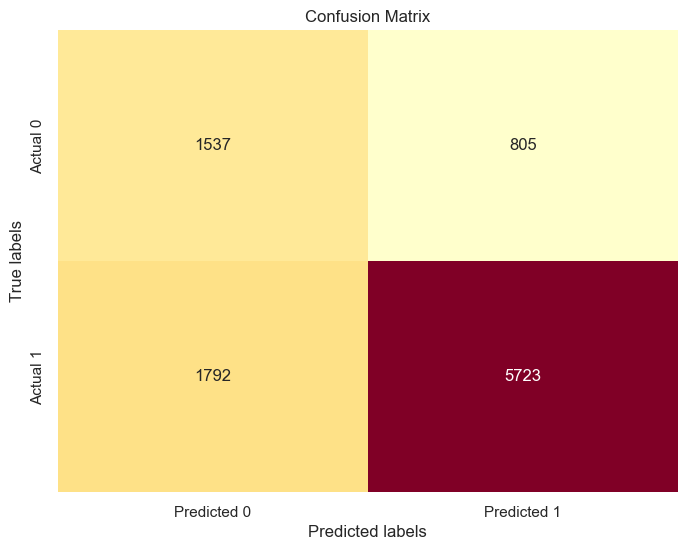

In [84]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap="YlOrRd", fmt="d", cbar=False,
            xticklabels=["Predicted 0", "Predicted 1"],
            yticklabels=["Actual 0", "Actual 1"])
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.title("Confusion Matrix")
plt.show()

# HYPERPARAMETER TUNİNG

# Shapley

In [85]:
!pip install shap
import shap

 99%|===================| 9741/9857 [01:21<00:00]        

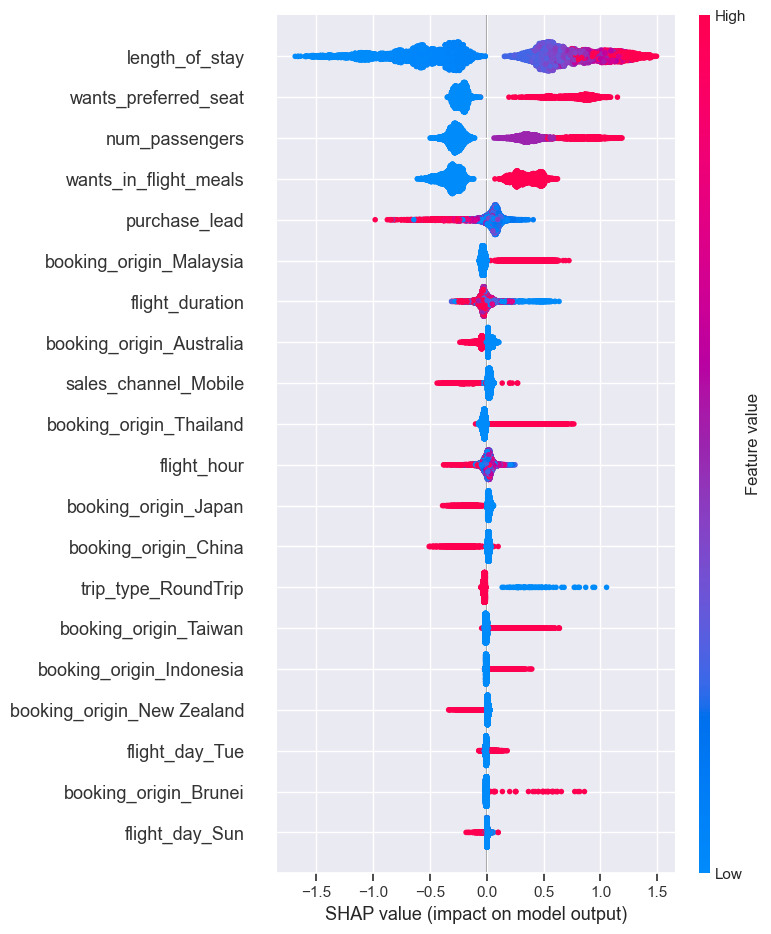

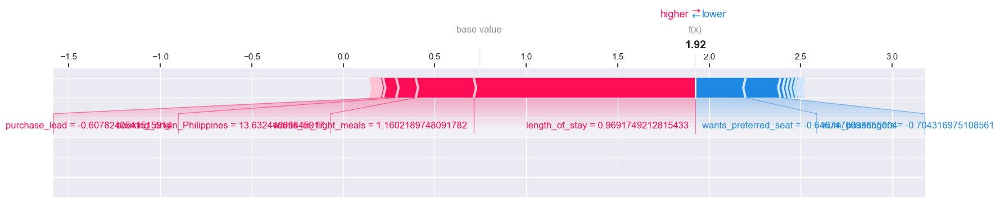

In [86]:
# SHAP Explainer objektini yaradmaq
explainer = shap.Explainer(lgb_model_new, X_train_new)

# SHAP dəyərlərini hesablamaq
shap_values = explainer.shap_values(X_test_new)

# SHAP summary plot göstərmək
shap.summary_plot(shap_values, X_test_new)

# Təsir nümunəsi üçün SHAP force plot göstərmək
shap.force_plot(explainer.expected_value, shap_values[0], X_test_new.iloc[0, :], matplotlib=True)

# Grid Search

In [87]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import roc_auc_score

# Define the model
lgb_model_new = lgb.LGBMClassifier(random_state=42)

# Define the parameter grid
param_grid = {
    "max_depth": [3, 5, 7, 10],
    "min_samples_split": [2, 5, 10]
}

# Initialize the GridSearchCV object with cross-validation
grid_search = GridSearchCV(estimator=lgb_model_new, param_grid=param_grid, cv=5, scoring="f1_macro")

# Fit the model
grid_search.fit(X, y)

# Best parameters and best score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: {:.2f}".format(grid_search.best_score_))

# Optionally, examine all results
for mean_score, params in zip(grid_search.cv_results_["mean_test_score"], grid_search.cv_results_["params"]):
    print(f"{mean_score:.3f} for {params}")


[LightGBM] [Warning] Unknown parameter: min_samples_split
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Unknown parameter: min_samples_split
[LightGBM] [Info] Number of positive: 26344, number of negative: 13080
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 420
[LightGBM] [Info] Number of data points in the train set: 39424, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.668222 -> initscore=0.700156
[LightGBM] [Info] Start training from score 0.700156
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

# Cross Validation

In [88]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer, f1_score

# Create the classifier with default or specified hyperparameters
lgb_model_new = lgb.LGBMClassifier(max_depth=7, min_samples_split=2)

# Perform cross-validation and return the average f1_macro score
scores = cross_val_score(lgb_model_new, X_train_new, y_train, cv=20, n_jobs=-1, scoring="f1_macro")

# Print the individual scores and the average score
print("Individual f1_macro scores from cross-validation: ", scores)
print("Average f1_macro score: {:.2f}".format(scores.mean()))

Individual f1_macro scores from cross-validation:  [0.6784259  0.66332261 0.66204793 0.67215802 0.66803049 0.65775114
 0.66429316 0.67431426 0.65489248 0.66695636 0.67763001 0.67707212
 0.68377071 0.67745062 0.66896364 0.66086547 0.66039113 0.65891969
 0.6768918  0.66119837]
Average f1_macro score: 0.67
